<a href="https://colab.research.google.com/github/plaban1981/Object_Detection/blob/main/Copy_of_cvlib_Yolo_Object_Detection_in_Seconds.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## cvlib

cvlib is a simple, easy-to-use, high level, open-source Computer Vision library for Python. The library was developed with a focus on enabling easy and fast experimentation. **Most of the Guided principles that cvlib has are heavily inspired by the famous Keras library(deep learning library used on top of TensorFlow).**

A few of these principles are:

* simplicity
* user-friendliness
* modularity and
* extensibility

## Installation

Provided the below python packages are installed, cvlib is completely pip installable.

* OpenCV
* Tensorflow

In [ ]:
! pip install opencv-python

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
! pip install cvlib

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 13.1 MB 5.3 MB/s 
  Created wheel for cvlib: filename=cvlib-0.2.7-py3-none-any.whl size=10046385 sha256=eddd66ad1e57810124cf622ac648a197823701ff67d25754240fd2e09209e272
  Stored in directory: /root/.cache/pip/wheels/8e/d7/31/bc643bd3a8b11a7368b1ab1d8a6299b33b462ed0b0683ddc5a
  Created wheel for progressbar: filename=progressbar-2.5-py3-none-any.whl size=12082 sha256=5ce9d8b9d81d3a2aaf5a0c2ab28a201e4adc9ce650ee2f99181b2ae9e8c22d4c
  Stored in directory: /root/.cache/pip/wheels/f0/fd/1f/3e35ed57e94cd8ced38dd46771f1f0f94f65fec548659ed855
Successfully built cvlib progressbar


## Face detection

In [ ]:
!wget "https://thumbs.dreamstime.com/z/three-girls-three-different-face-expression-friendship-people-pajama-party-concept-happy-friends-teenage-girls-having-111832531.jpg"

--2022-10-09 11:15:11--  https://thumbs.dreamstime.com/z/three-girls-three-different-face-expression-friendship-people-pajama-party-concept-happy-friends-teenage-girls-having-111832531.jpg
Resolving thumbs.dreamstime.com (thumbs.dreamstime.com)... 192.229.163.122
Connecting to thumbs.dreamstime.com (thumbs.dreamstime.com)|192.229.163.122|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 98296 (96K) [image/jpeg]
Saving to: ‘three-girls-three-different-face-expression-friendship-people-pajama-party-concept-happy-friends-teenage-girls-having-111832531.jpg’

three-girls-three-d 100%[===================>]  95.99K  --.-KB/s    in 0.05s   

2022-10-09 11:15:12 (1.90 MB/s) - ‘three-girls-three-different-face-expression-friendship-people-pajama-party-concept-happy-friends-teenage-girls-having-111832531.jpg’ saved [98296/98296]



In [ ]:
import cv2
import cvlib as cv
import numpy as np
image = cv2.imread("/content/three-girls-three-different-face-expression-friendship-people-pajama-party-concept-happy-friends-teenage-girls-having-111832531.jpg")
faces, confidences = cv.detect_face(image) 

In [ ]:
faces

[[583, 180, 759, 425], [863, 197, 1031, 430], [194, 158, 360, 363]]

In [ ]:
confidences

[0.99997663, 0.9998629, 0.57427764]

## Visualize face detection images using opencv

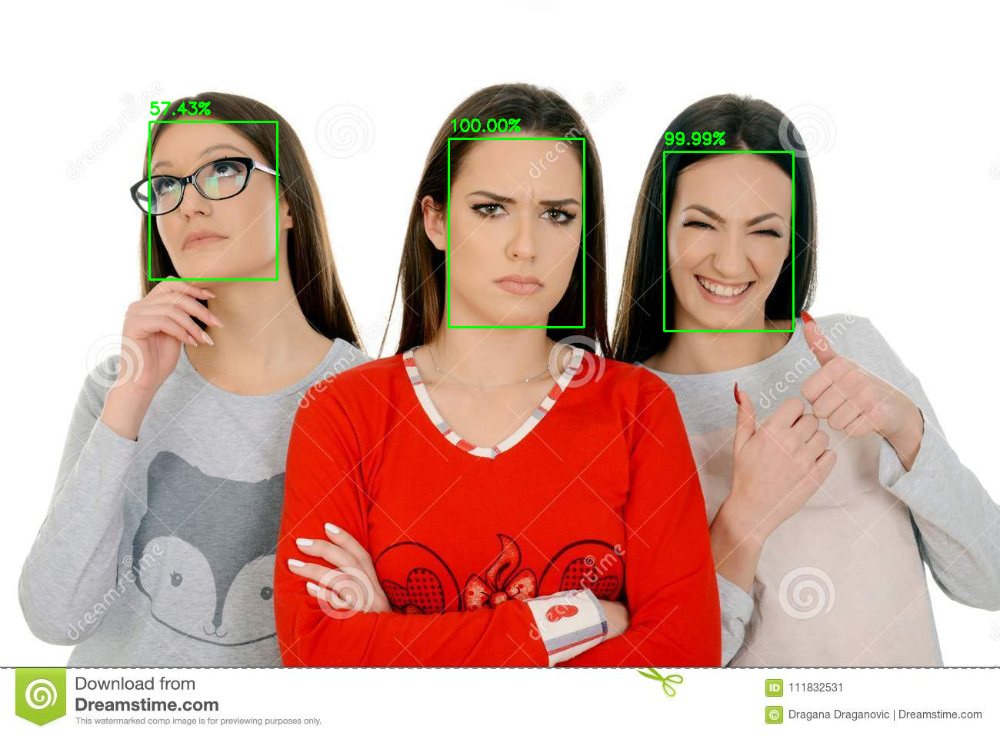

In [ ]:
from google.colab.patches import cv2_imshow
# loop through detected faces
for face,conf in zip(faces,confidences):

    (startX,startY) = face[0],face[1]
    (endX,endY) = face[2],face[3]
    # draw rectangle over face
    cv2.rectangle(image, (startX,startY), (endX,endY), (0,255,0), 2)
    label = "{:.2f}%".format(conf * 100)
    Y = startY - 10 if startY - 10 > 10 else startY + 10

    cv2.putText(image, label, (startX, Y),  cv2.FONT_HERSHEY_SIMPLEX,0.7, (0, 255, 0), 2)
cv2_imshow(image)

## save output


In [ ]:
cv2.imwrite("face_detection.jpg", image)

True

## Draw bounding boxes on an image in PyTorch

tensor([[ 583,  180,  759,  425],
        [ 863,  197, 1031,  430],
        [ 194,  158,  360,  363]], dtype=torch.int32)
torch.Size([3, 4])


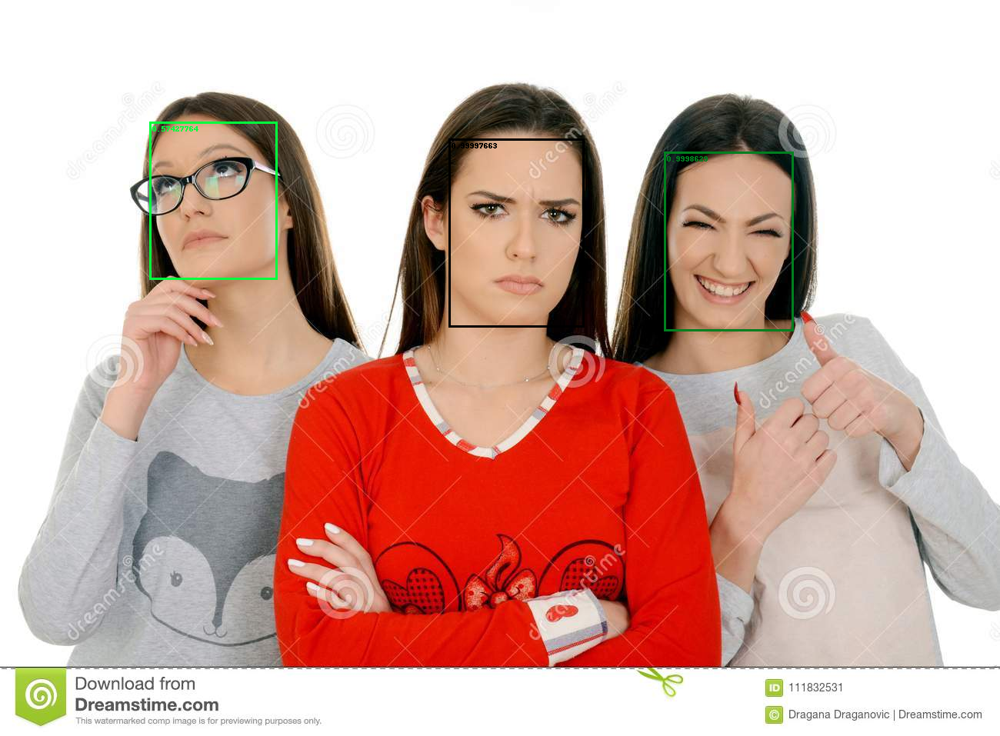

In [ ]:
import torch
import torchvision
from torchvision.io import read_image
from torchvision.utils import draw_bounding_boxes
img = read_image('/content/three-girls-three-different-face-expression-friendship-people-pajama-party-concept-happy-friends-teenage-girls-having-111832531.jpg')
bbox = torch.tensor(faces, dtype=torch.int)
print(bbox)
print(bbox.size())
lbl = [str(cf) for cf in confidences]
# draw bounding boxes on the input image
img=draw_bounding_boxes(img, bbox,labels = lbl,width=3)
img = torchvision.transforms.ToPILImage()(img)
img

## Gender Detection

* Once face is detected, it can be passed on to detect_gender() function to recognize gender. 
* It will return the labels (man, woman) and associated probabilities.

In [ ]:
for face,conf in zip(faces,confidences):

    (startX,startY) = face[0],face[1]
    (endX,endY) = face[2],face[3]
    # draw rectangle over face
    cv2.rectangle(image, (startX,startY), (endX,endY), (0,255,0), 2)
    face_crop = np.copy(image[startY:endY, startX:endX])

    # apply gender detection
    (label, confidence) = cv.detect_gender(face_crop)

    print(confidence)
    print(label)

    idx = np.argmax(confidence)
    label = label[idx]

    label = "{}: {:.2f}%".format(label, confidence[idx] * 100)

    Y = startY - 10 if startY - 10 > 10 else startY + 10

    cv2.putText(image, label, (startX, Y),  cv2.FONT_HERSHEY_SIMPLEX,0.7, (0, 255, 0), 2)


[0.99630046 0.00369946]
['male', 'female']
[0.7905769  0.20942311]
['male', 'female']
[0.3924667 0.6075333]
['male', 'female']


#### Syntax: cv2.putText(image, text, org, font, fontScale, color[, thickness[, lineType[, bottomLeftOrigin]]])

#### Parameters:
* **image**: It is the image on which text is to be drawn.
* **text**: Text string to be drawn.
* **org**: It is the coordinates of the bottom-left corner of the text string in the image. The coordinates are represented as tuples of two values i.e. (X coordinate value, Y coordinate value).
* **font**: It denotes the font type. Some of font types are FONT_HERSHEY_SIMPLEX, FONT_HERSHEY_PLAIN, , etc.
* **fontScale**: Font scale factor that is multiplied by the font-specific base size.
* **color**: It is the color of text string to be drawn. For BGR, we pass a tuple. eg: (255, 0, 0) for blue color.
* **thickness**: It is the thickness of the line in px.
* **lineType**: This is an optional parameter.It gives the type of the line to be used.
* **bottomLeftOrigin**: This is an optional parameter. When it is true, the image data origin is at the bottom-left corner. Otherwise, it is at the top-left corner.

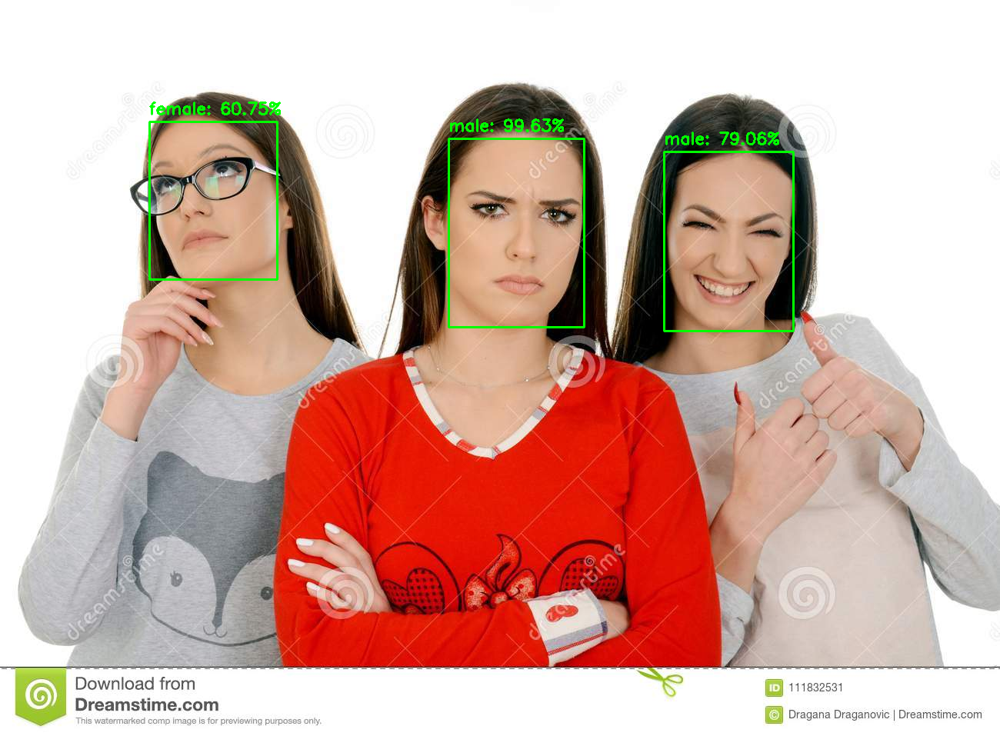

In [ ]:
cv2_imshow(image)

## Object Detection using cvlib

In [ ]:
!wget https://www.iihs.org/media/23a6c599-71ba-4d57-909c-cee62905e328/ga6CCw/Status%20Report/45-10/story-4-main-image.jpg

--2022-10-09 10:50:24--  https://www.iihs.org/media/23a6c599-71ba-4d57-909c-cee62905e328/ga6CCw/Status%20Report/45-10/story-4-main-image.jpg
Resolving www.iihs.org (www.iihs.org)... 172.67.16.206, 104.20.173.79, 104.20.172.79, ...
Connecting to www.iihs.org (www.iihs.org)|172.67.16.206|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 297756 (291K) [image/jpeg]
Saving to: ‘story-4-main-image.jpg’

story-4-main-image. 100%[===================>] 290.78K  1.73MB/s    in 0.2s    

2022-10-09 10:50:34 (1.73 MB/s) - ‘story-4-main-image.jpg’ saved [297756/297756]



In [ ]:
! wget https://miro.medium.com/max/1100/1*4QW4-Yz6izpbyCiZv6bSPA.jpeg

--2022-10-09 11:56:57--  https://miro.medium.com/max/1100/1*4QW4-Yz6izpbyCiZv6bSPA.jpeg
Resolving miro.medium.com (miro.medium.com)... 162.159.153.4, 162.159.152.4, 2606:4700:7::a29f:9804, ...
Connecting to miro.medium.com (miro.medium.com)|162.159.153.4|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 55827 (55K) [image/jpeg]
Saving to: ‘1*4QW4-Yz6izpbyCiZv6bSPA.jpeg.1’

1*4QW4-Yz6izpbyCiZv 100%[===================>]  54.52K  --.-KB/s    in 0s      

2022-10-09 11:56:57 (112 MB/s) - ‘1*4QW4-Yz6izpbyCiZv6bSPA.jpeg.1’ saved [55827/55827]



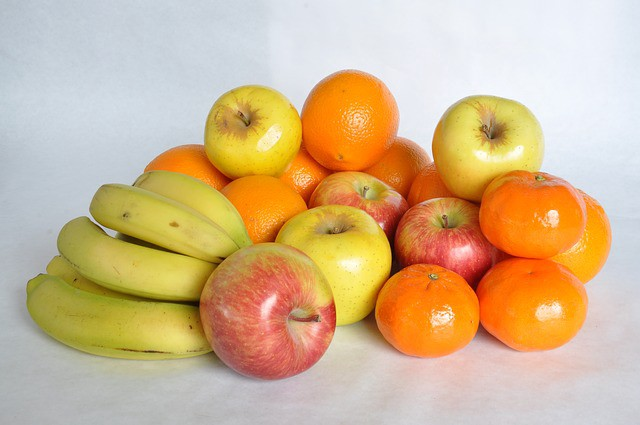

In [ ]:
from google.colab.patches import cv2_imshow
image = cv2.imread("/content/1*4QW4-Yz6izpbyCiZv6bSPA.jpeg")
cv2_imshow(image)

In [ ]:
# import necessary packages
import cvlib as cv
import cv2
from cvlib.object_detection import draw_bbox
# apply object detection
bbox, label, conf = cv.detect_common_objects(image)

print(bbox, label, conf)

# draw bounding box over detected objects
out = draw_bbox(image, bbox, label, conf)

[[374, 261, 478, 358], [194, 242, 339, 379], [299, 71, 399, 171], [218, 174, 308, 243], [478, 257, 585, 350], [276, 148, 329, 201], [305, 172, 406, 242], [144, 144, 229, 189], [273, 202, 396, 327], [207, 88, 299, 176], [393, 203, 494, 279], [476, 173, 591, 264], [432, 92, 541, 203]] ['orange', 'apple', 'orange', 'orange', 'orange', 'orange', 'apple', 'orange', 'apple', 'apple', 'apple', 'orange', 'apple'] [0.9407585263252258, 0.9342194199562073, 0.918720006942749, 0.9146913886070251, 0.8850492238998413, 0.8160790205001831, 0.7858515381813049, 0.7153841853141785, 0.7064777612686157, 0.6565555334091187, 0.5910966992378235, 0.5888282060623169, 0.572316586971283]


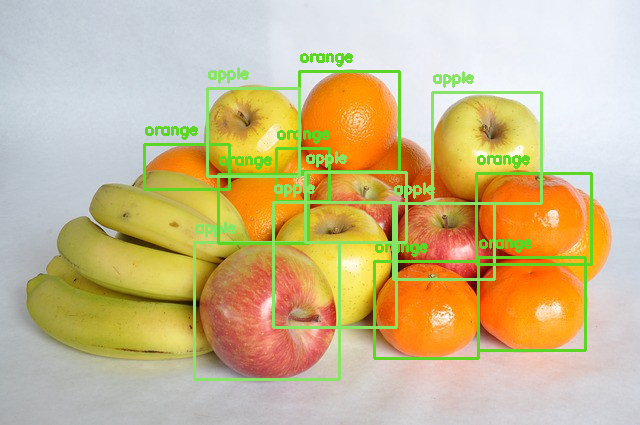

In [ ]:
cv2_imshow(out)

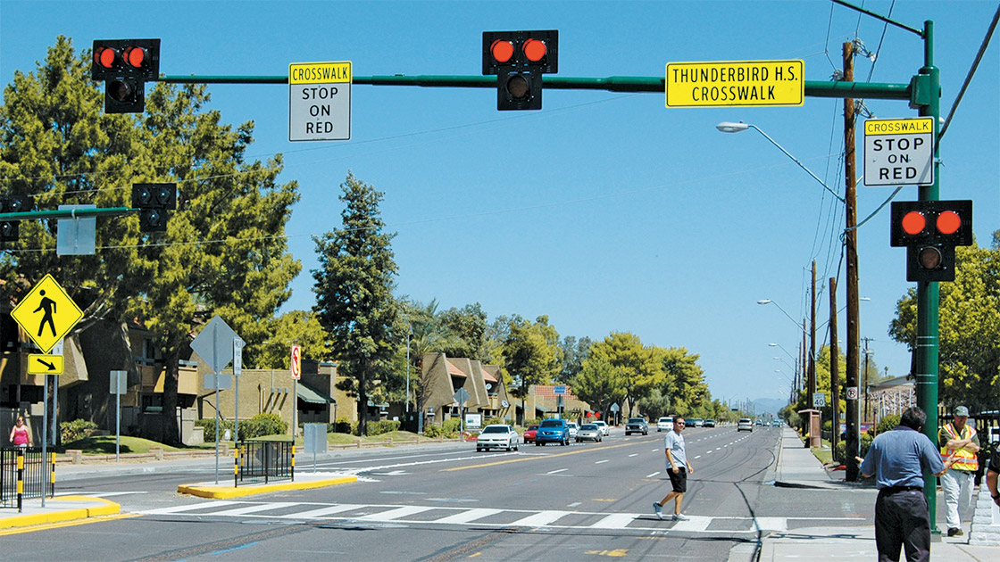

In [ ]:
image = cv2.imread("/content/story-4-main-image.jpg")
cv2_imshow(image)

In [ ]:
# import necessary packages
import cvlib as cv
import cv2
from cvlib.object_detection import draw_bbox
# apply object detection
bbox, label, conf = cv.detect_common_objects(image)

print(bbox, label, conf)

# draw bounding box over detected objects
out = draw_bbox(image, bbox, label, conf)

[[968, 457, 1057, 629], [541, 31, 624, 124], [731, 466, 774, 581], [532, 476, 579, 508], [824, 471, 844, 483], [103, 43, 177, 127], [699, 466, 726, 487], [775, 469, 800, 479], [598, 470, 637, 500], [1048, 458, 1100, 600], [642, 474, 676, 496], [994, 222, 1089, 278], [732, 467, 752, 482]] ['person', 'traffic light', 'person', 'car', 'car', 'traffic light', 'car', 'car', 'car', 'person', 'car', 'traffic light', 'car'] [0.9955678582191467, 0.986333966255188, 0.980908989906311, 0.9607056379318237, 0.9155279397964478, 0.9065165519714355, 0.8890355229377747, 0.8488156199455261, 0.8464000821113586, 0.8286918997764587, 0.7284528017044067, 0.707533597946167, 0.6250352263450623]


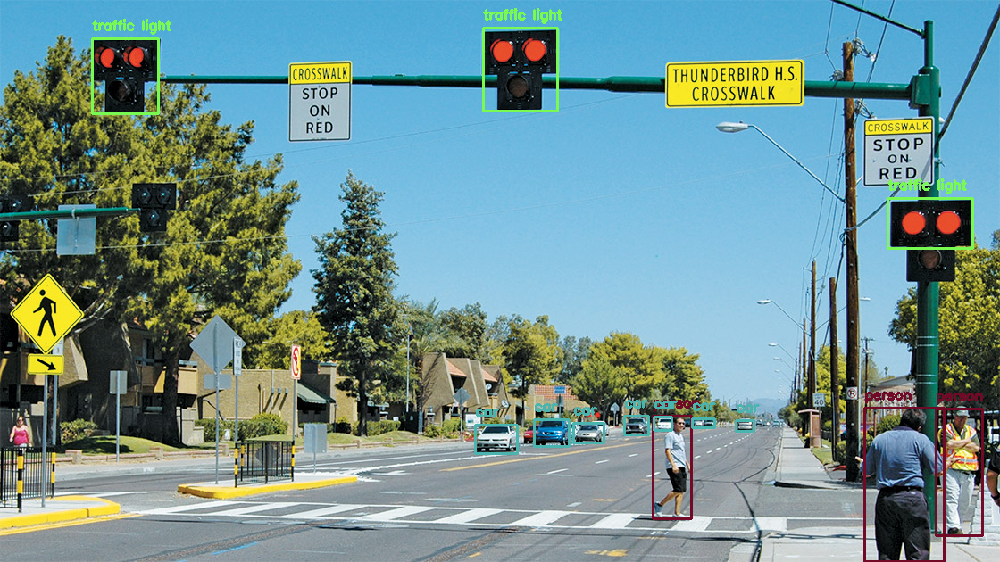

In [ ]:
cv2_imshow(out)

## Object Detection from Video

In [ ]:
#install pytube library to download youtube video
! pip install pytube -q

     |████████████████████████████████| 56 kB 2.5 MB/s 


##Download the YouTube Video

In [ ]:
# importing the module  
#https://www.youtube.com/watch?v=jWO99MLJ5Xo
from pytube import YouTube  
yt = YouTube('https://www.youtube.com/watch?v=jWO99MLJ5Xo')  
print(yt.title)

Short funny animal video clips


In [ ]:
myStream = YouTube('https://www.youtube.com/watch?v=jWO99MLJ5Xo').streams.first()
filename = myStream.download()

In [ ]:
# import necessary packages
import cvlib as cv
from cvlib.object_detection import draw_bbox
import cv2
import sys

In [ ]:
# open webcam
video_path = "/content/Short funny animal video clips.3gpp"
video = cv2.VideoCapture(video_path)
if not video.isOpened():
    print("Could not open video")
    exit()

[[26, 2, 147, 145], [49, 16, 99, 64]] ['tv', 'person'] [0.7264032363891602, 0.4265053868293762]


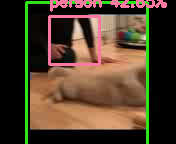

[[21, -2, 152, 146], [24, 9, 121, 66]] ['tv', 'person'] [0.45555800199508667, 0.3071932792663574]


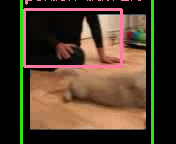

[[24, 8, 129, 71]] ['person'] [0.6432019472122192]


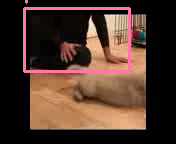

[[48, 8, 129, 70]] ['person'] [0.4611687958240509]


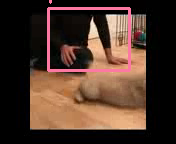

[[43, 7, 127, 73]] ['person'] [0.5589784979820251]


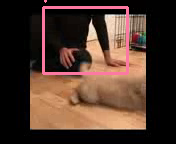

[[29, 5, 120, 72]] ['person'] [0.5593744516372681]


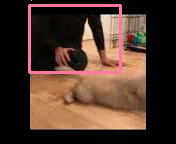

[[34, 12, 112, 68], [28, 1, 148, 138]] ['person', 'tv'] [0.7383490800857544, 0.3009054660797119]


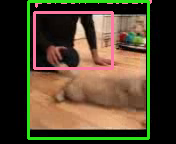

[[28, 12, 102, 67], [29, 2, 147, 141]] ['person', 'tv'] [0.6541300415992737, 0.391895592212677]


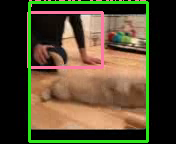

[[34, 14, 88, 62], [5, -2, 147, 148]] ['person', 'tv'] [0.7107871174812317, 0.5693990588188171]


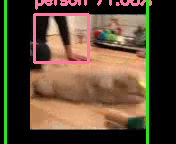

[[25, 0, 146, 142], [31, 13, 64, 60]] ['tv', 'person'] [0.7528954744338989, 0.5168430209159851]


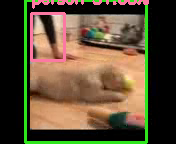

[] [] []


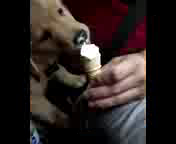

[[32, 1, 141, 145]] ['person'] [0.3694462180137634]


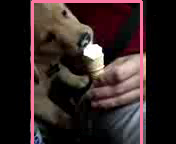

[[28, 0, 144, 145]] ['person'] [0.44957223534584045]


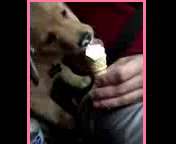

[[30, 1, 144, 143]] ['person'] [0.27574774622917175]


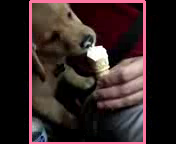

[] [] []


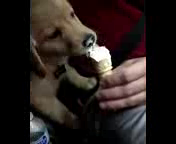

[] [] []


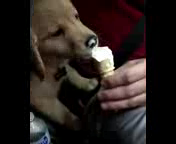

[[27, -5, 121, 145]] ['dog'] [0.2772539258003235]


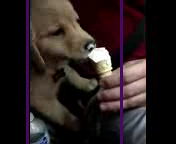

[[26, -2, 125, 144]] ['person'] [0.475558340549469]


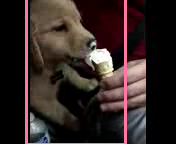

[[20, -5, 129, 147]] ['person'] [0.5959144830703735]


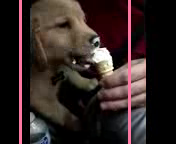

[[23, -1, 126, 145]] ['dog'] [0.49807047843933105]


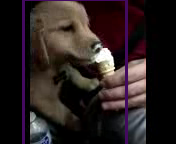

[[26, -3, 145, 147], [29, 109, 55, 142]] ['person', 'bottle'] [0.6062229871749878, 0.27498114109039307]


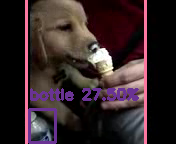

[[21, -4, 128, 146], [-1, -1, 33, 143]] ['person', 'cell phone'] [0.7271441221237183, 0.25552546977996826]


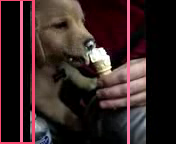

[[26, -8, 146, 150]] ['person'] [0.30335959792137146]


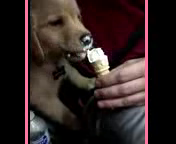

[[27, -4, 145, 146]] ['person'] [0.48002058267593384]


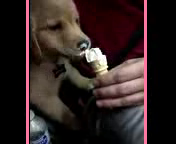

[[55, -2, 146, 144]] ['person'] [0.41715046763420105]


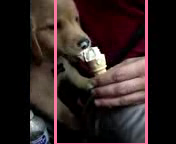

[[86, 47, 107, 74], [29, 107, 55, 142]] ['toothbrush', 'bottle'] [0.3991614282131195, 0.2573993504047394]


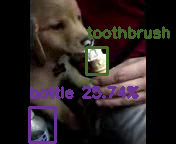

[[28, 107, 53, 143]] ['bottle'] [0.2627750337123871]


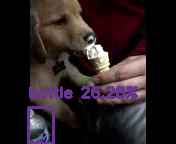

[[27, 10, 145, 136]] ['tv'] [0.8549637198448181]


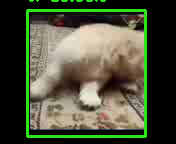

[[21, 10, 153, 134]] ['tv'] [0.4621094763278961]


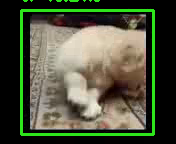

[[47, 21, 145, 127]] ['dog'] [0.459354043006897]


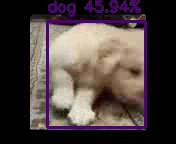

[[26, 13, 143, 134]] ['tv'] [0.8266679048538208]


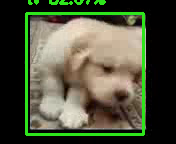

[[3, 8, 151, 138]] ['tv'] [0.49083590507507324]


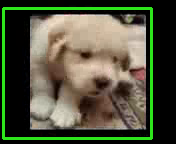

[[26, 9, 148, 134]] ['tv'] [0.6808090806007385]


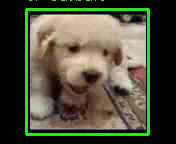

[[30, 10, 143, 118]] ['dog'] [0.8126559853553772]


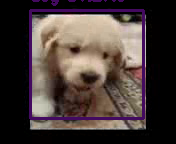

[[24, 11, 147, 134]] ['tv'] [0.2770058512687683]


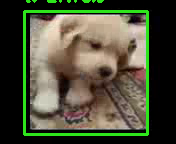

[[13, 14, 140, 131]] ['tv'] [0.803337037563324]


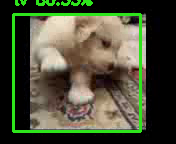

[] [] []


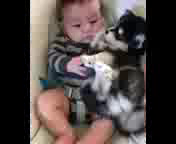

[[36, 1, 137, 142]] ['person'] [0.8069861531257629]


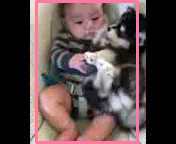

[[41, 0, 141, 143], [0, 0, 30, 139]] ['person', 'refrigerator'] [0.9603079557418823, 0.2622395157814026]


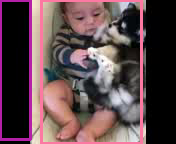

[[39, 0, 142, 143]] ['person'] [0.9560276865959167]


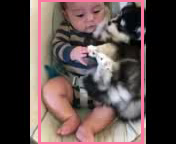

[[43, 2, 138, 142]] ['person'] [0.9755315184593201]


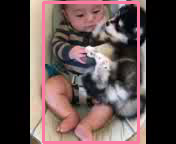

[[40, 3, 139, 140], [88, 50, 112, 92]] ['person', 'remote'] [0.9726616740226746, 0.3304031789302826]


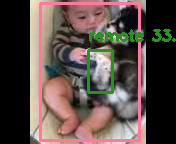

[[40, 2, 137, 141]] ['person'] [0.9548904299736023]


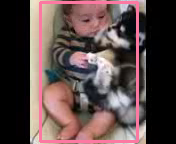

[[36, 0, 142, 143], [90, 63, 114, 98]] ['person', 'remote'] [0.9753850698471069, 0.33035799860954285]


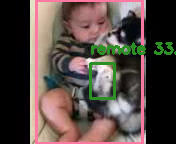

[[35, 2, 142, 141]] ['person'] [0.9624637365341187]


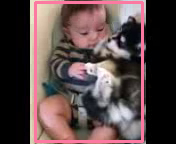

[[33, 5, 143, 141], [142, 2, 175, 142]] ['person', 'tv'] [0.9271528124809265, 0.2892085313796997]


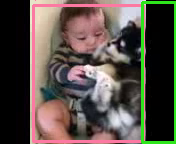

[[31, 1, 145, 142]] ['person'] [0.8767734169960022]


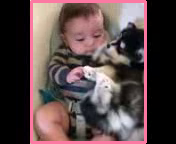

[[30, 0, 144, 143]] ['person'] [0.903140127658844]


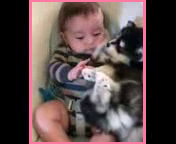

[[33, 1, 145, 143]] ['person'] [0.9451828002929688]


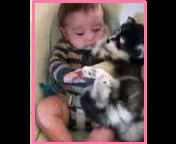

[[34, 0, 143, 143]] ['person'] [0.9602490067481995]


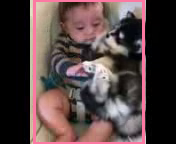

[[33, -2, 144, 144]] ['person'] [0.8954771757125854]


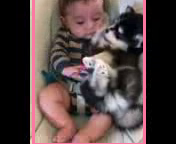

[[37, -1, 141, 145]] ['person'] [0.8516638875007629]


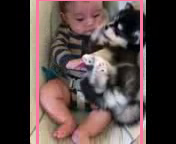

[[36, 0, 143, 144]] ['person'] [0.8788477778434753]


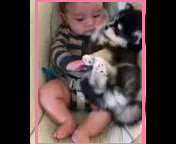

[[35, 0, 143, 146]] ['person'] [0.877859890460968]


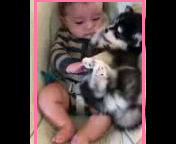

[[32, -1, 144, 145]] ['person'] [0.9021066427230835]


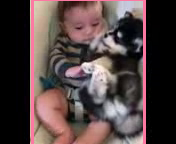

[[33, 2, 143, 143]] ['person'] [0.7245567440986633]


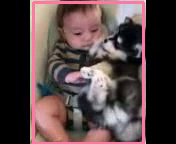

[[31, 1, 144, 143]] ['person'] [0.7944062352180481]


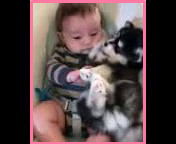

[[27, 2, 120, 142]] ['person'] [0.8249678015708923]


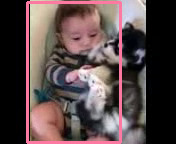

[[30, 0, 143, 146]] ['person'] [0.8487786650657654]


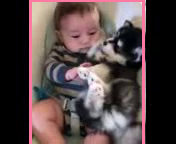

[[29, 0, 145, 144]] ['person'] [0.9552149772644043]


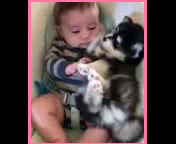

[[30, 1, 144, 143]] ['person'] [0.8993368744850159]


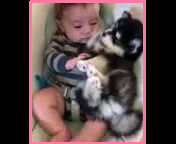

[[30, 0, 141, 142]] ['person'] [0.9557933807373047]


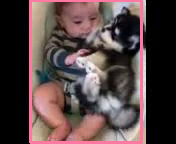

[[30, 1, 142, 141]] ['person'] [0.9194115996360779]


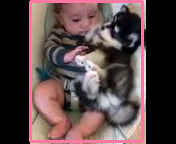

[[29, 0, 144, 143]] ['person'] [0.8881056904792786]


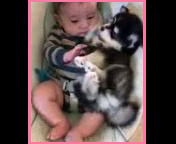

[[27, 1, 142, 142]] ['person'] [0.9715469479560852]


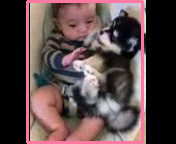

[[30, 2, 144, 143]] ['person'] [0.9229574203491211]


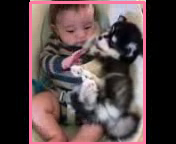

[[27, 0, 144, 144]] ['person'] [0.8232629895210266]


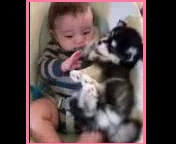

[[29, 1, 143, 143]] ['person'] [0.7751593589782715]


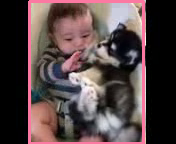

[[29, 0, 143, 141]] ['person'] [0.654554009437561]


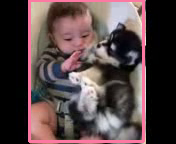

[[29, 0, 143, 143]] ['person'] [0.6992008686065674]


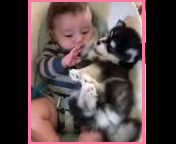

[[31, 0, 142, 146]] ['person'] [0.7585041522979736]


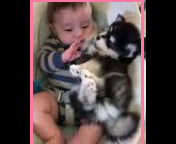

[[30, 0, 141, 144]] ['person'] [0.9047385454177856]


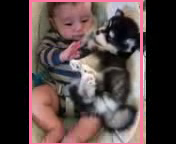

[[29, -1, 143, 145]] ['person'] [0.9592090845108032]


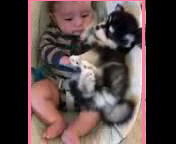

[[28, 0, 123, 142]] ['person'] [0.8595485687255859]


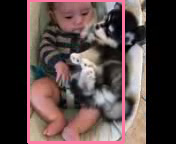

[[30, 1, 143, 142]] ['person'] [0.7770111560821533]


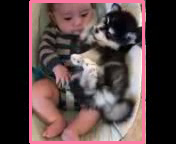

[[30, 0, 117, 144]] ['person'] [0.6662800312042236]


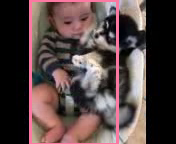

[[32, 0, 114, 144]] ['person'] [0.7295992970466614]


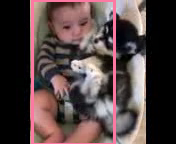

[[28, 0, 145, 144]] ['person'] [0.6385089755058289]


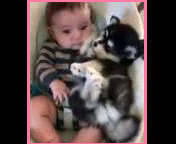

[[29, 0, 145, 141]] ['person'] [0.5748350024223328]


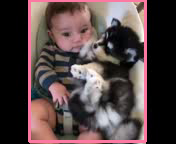

[[26, -7, 146, 149]] ['person'] [0.6791976690292358]


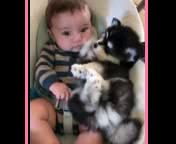

[[32, 2, 114, 142], [79, 72, 99, 110]] ['person', 'remote'] [0.5673313140869141, 0.46988552808761597]


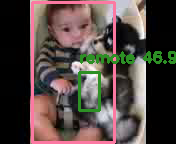

[[31, 2, 115, 141], [71, 60, 99, 75], [72, 69, 101, 97]] ['person', 'remote', 'remote'] [0.812859833240509, 0.3758912980556488, 0.2722837030887604]


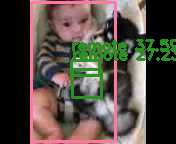

[[27, 1, 123, 143]] ['person'] [0.6025977730751038]


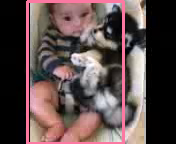

[[30, -2, 142, 144]] ['person'] [0.5585076212882996]


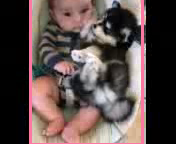

[[32, 0, 118, 142]] ['person'] [0.7694337964057922]


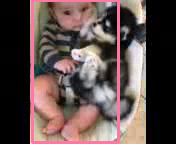

[[31, -1, 143, 143]] ['person'] [0.853296160697937]


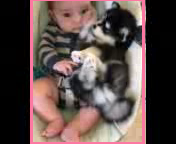

[[31, 0, 143, 143]] ['person'] [0.718453049659729]


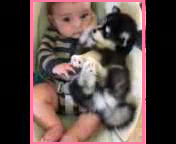

[[26, -2, 124, 146]] ['person'] [0.6466149091720581]


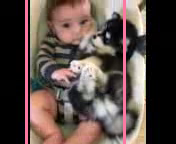

[[26, 0, 123, 143]] ['person'] [0.2511062026023865]


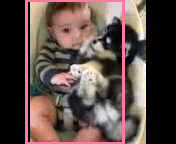

[[25, 1, 125, 142]] ['person'] [0.5979663729667664]


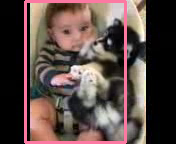

[[23, 1, 126, 143]] ['person'] [0.6059978604316711]


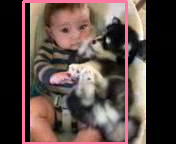

[[25, -1, 149, 145]] ['person'] [0.5933756828308105]


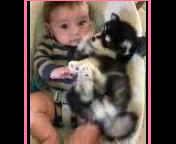

[[31, 0, 142, 143]] ['person'] [0.8292619585990906]


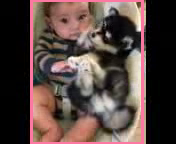

[[28, 1, 143, 142]] ['person'] [0.7387409210205078]


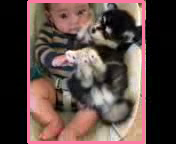

[[28, 2, 141, 142]] ['person'] [0.8345218896865845]


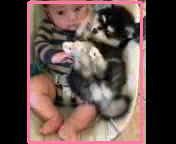

[[30, 0, 119, 142]] ['person'] [0.6520766019821167]


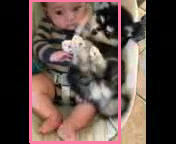

[[30, -1, 118, 143]] ['person'] [0.6247603893280029]


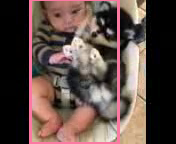

[[25, 10, 148, 131]] ['tv'] [0.8504754900932312]


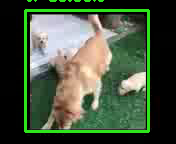

[[15, 10, 161, 136]] ['tv'] [0.3739634156227112]


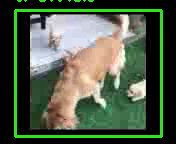

[[32, 14, 146, 131]] ['tv'] [0.6960238814353943]


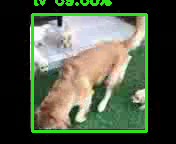

[[29, 12, 144, 134]] ['tv'] [0.713970422744751]


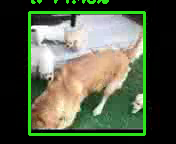

[[22, 9, 152, 137]] ['tv'] [0.8973193168640137]


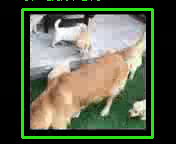

[[25, 12, 153, 134]] ['tv'] [0.9479812979698181]


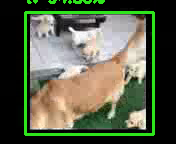

[[26, 11, 151, 134]] ['tv'] [0.8934686779975891]


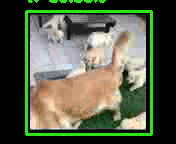

[[25, 13, 150, 130]] ['tv'] [0.8487001061439514]


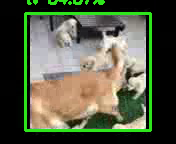

[[21, 10, 152, 137]] ['tv'] [0.923217236995697]


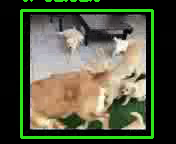

[[21, 11, 154, 135]] ['tv'] [0.9795472025871277]


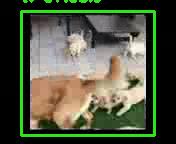

[[25, 10, 146, 135]] ['tv'] [0.9429467916488647]


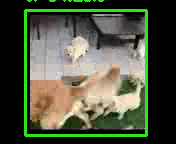

[[23, 13, 150, 137]] ['tv'] [0.9165765047073364]


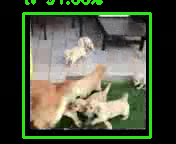

[[27, 11, 146, 136]] ['tv'] [0.9588308930397034]


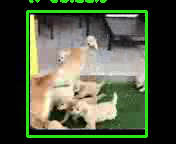

[[24, 10, 150, 137]] ['tv'] [0.9104259014129639]


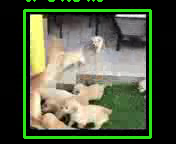

[[23, 10, 148, 136]] ['tv'] [0.9593089818954468]


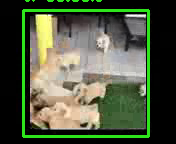

[[22, 6, 148, 138]] ['tv'] [0.9392150640487671]


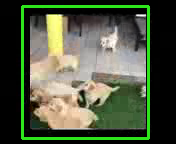

[[22, 1, 150, 140]] ['tv'] [0.9674737453460693]


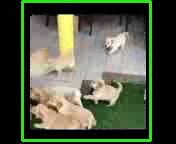

[[23, 6, 150, 140]] ['tv'] [0.9672888517379761]


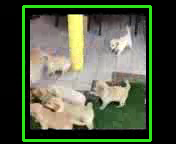

[[23, 12, 155, 135]] ['tv'] [0.9713696241378784]


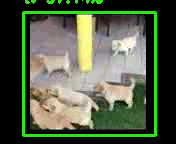

[[27, 12, 146, 135]] ['tv'] [0.9866313934326172]


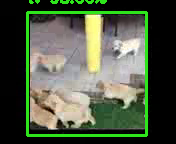

[[26, 12, 145, 136]] ['tv'] [0.9807344079017639]


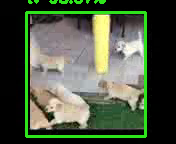

[[26, 9, 148, 137]] ['tv'] [0.9811468124389648]


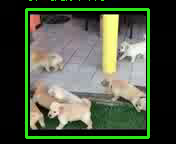

[[21, 13, 150, 135]] ['tv'] [0.960242748260498]


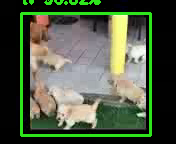

[[26, 9, 150, 137]] ['tv'] [0.9533709287643433]


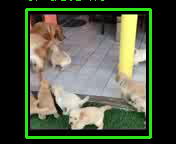

[[8, 6, 145, 141]] ['tv'] [0.8839526772499084]


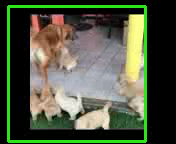

[[19, 10, 153, 137]] ['tv'] [0.9347143173217773]


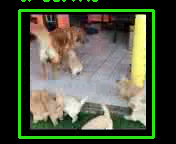

[[24, 10, 149, 137]] ['tv'] [0.9088510870933533]


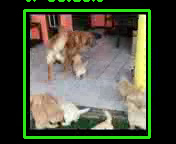

[[18, 6, 155, 142]] ['tv'] [0.9406723976135254]


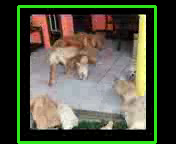

[[4, 6, 148, 138], [29, 95, 74, 128]] ['tv', 'dog'] [0.9150809049606323, 0.31990906596183777]


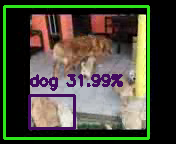

[[24, 6, 148, 137]] ['tv'] [0.9537022709846497]


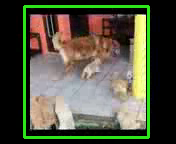

[[13, 2, 162, 140]] ['tv'] [0.8851249814033508]


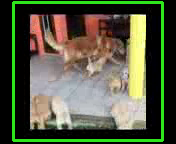

[[19, 9, 155, 136]] ['tv'] [0.7759106159210205]


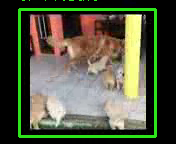

[[21, 9, 154, 136]] ['tv'] [0.8960834741592407]


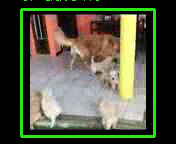

[[20, 5, 153, 136]] ['tv'] [0.9364102482795715]


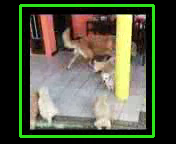

[[22, 2, 153, 139]] ['tv'] [0.831763505935669]


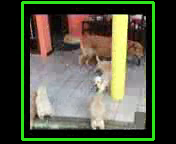

[[21, 9, 152, 134]] ['tv'] [0.687307596206665]


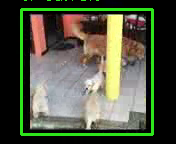

[[17, 6, 154, 138]] ['tv'] [0.8523218035697937]


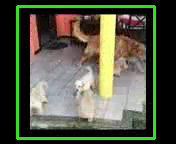

[[22, 6, 148, 139]] ['tv'] [0.932441234588623]


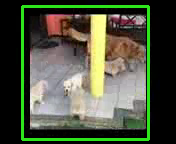

[[26, 5, 146, 141]] ['tv'] [0.9130674600601196]


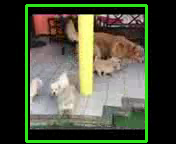

[[23, 3, 151, 140]] ['tv'] [0.957317590713501]


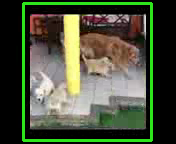

[[21, 5, 153, 140]] ['tv'] [0.9642744064331055]


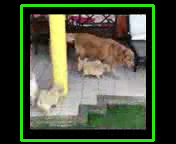

[[17, 9, 158, 139], [55, 16, 128, 78]] ['tv', 'cat'] [0.8377517461776733, 0.33724644780158997]


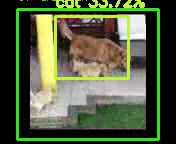

[[25, 1, 149, 142], [62, 34, 131, 81]] ['tv', 'dog'] [0.9130162596702576, 0.4352448582649231]


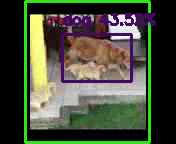

[[21, 5, 156, 140]] ['tv'] [0.9425221085548401]


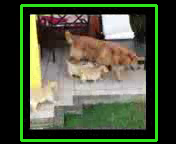

[[25, 10, 151, 140]] ['tv'] [0.9249691367149353]


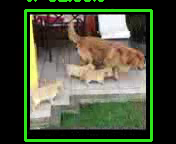

[[20, 8, 152, 139]] ['tv'] [0.8895286321640015]


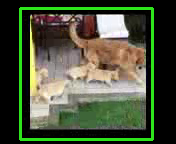

[[21, 4, 157, 141]] ['tv'] [0.9488425850868225]


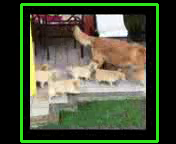

[[23, 5, 152, 141]] ['tv'] [0.9467255473136902]


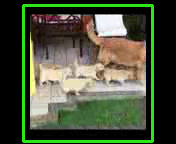

[[14, 6, 160, 139]] ['tv'] [0.8920513391494751]


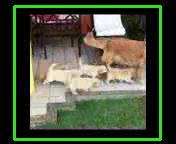

[[21, 2, 155, 141]] ['tv'] [0.9441238045692444]


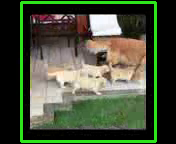

[[17, 5, 154, 139]] ['tv'] [0.8979946374893188]


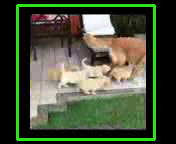

[[19, 6, 155, 141]] ['tv'] [0.768435001373291]


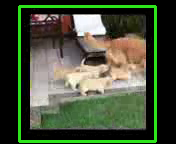

[[21, 3, 154, 141]] ['tv'] [0.8204161524772644]


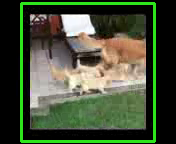

[[21, 1, 152, 142]] ['tv'] [0.8301015496253967]


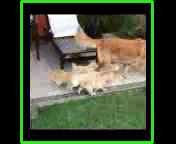

[[37, 8, 136, 141]] ['person'] [0.3019922971725464]


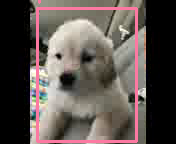

[[30, 14, 141, 143]] ['dog'] [0.8812874555587769]


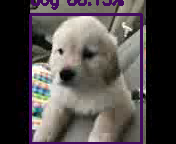

[[29, 13, 144, 142], [0, 0, 32, 142]] ['dog', 'tv'] [0.9179222583770752, 0.3348851799964905]


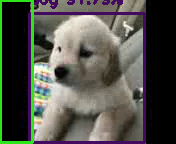

[[32, 14, 143, 142], [0, 0, 30, 143]] ['dog', 'tv'] [0.8262012004852295, 0.5064464211463928]


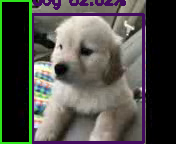

[[33, 18, 144, 142], [0, 0, 30, 144]] ['dog', 'tv'] [0.9587900042533875, 0.4023136794567108]


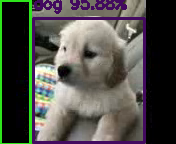

[[34, 15, 143, 142], [0, 0, 30, 144]] ['dog', 'laptop'] [0.9574289917945862, 0.3882235288619995]


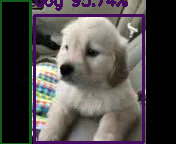

[[35, 14, 143, 141], [-1, 0, 31, 144]] ['dog', 'laptop'] [0.9586684107780457, 0.43218645453453064]


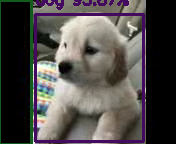

[[34, 6, 139, 143]] ['dog'] [0.9792068600654602]


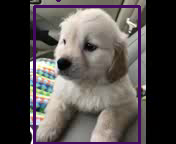

[[33, 9, 143, 143], [-1, 0, 31, 142]] ['dog', 'laptop'] [0.9810004830360413, 0.26061174273490906]


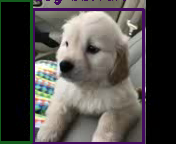

[[34, 9, 144, 143], [0, -1, 32, 143]] ['dog', 'laptop'] [0.9552052617073059, 0.3085407316684723]


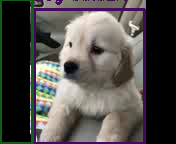

[[33, 8, 142, 142], [-1, 0, 31, 143]] ['dog', 'laptop'] [0.9413992762565613, 0.30265456438064575]


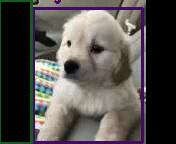

[[32, 7, 142, 142]] ['dog'] [0.9637009501457214]


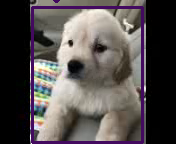

[[31, 4, 139, 141]] ['dog'] [0.9623409509658813]


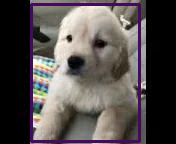

[[29, 4, 140, 142]] ['dog'] [0.9620904326438904]


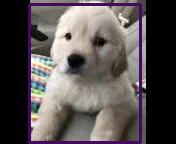

[[29, 2, 139, 143]] ['dog'] [0.9736233949661255]


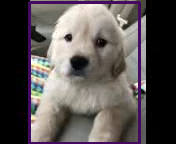

[[30, 2, 138, 146]] ['dog'] [0.9523942470550537]


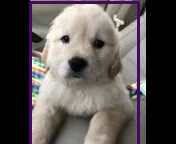

[[32, 2, 136, 144]] ['dog'] [0.9536876082420349]


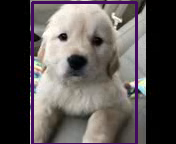

[[30, 2, 128, 143]] ['dog'] [0.9454929232597351]


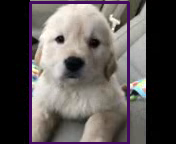

[[29, 2, 126, 143]] ['dog'] [0.9525198936462402]


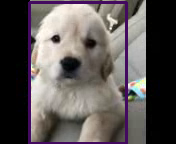

[[29, 1, 127, 142]] ['dog'] [0.9665196537971497]


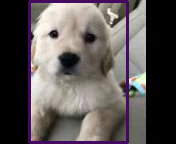

[[26, 0, 127, 143]] ['dog'] [0.8821955919265747]


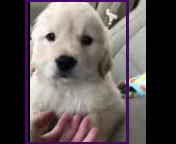

[[30, 1, 126, 147]] ['dog'] [0.931121826171875]


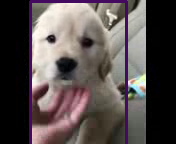

[[28, 3, 125, 145]] ['dog'] [0.921844482421875]


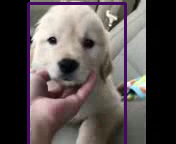

[[28, 2, 128, 141]] ['dog'] [0.8446605801582336]


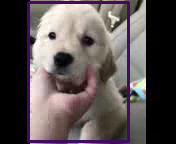

[[28, 5, 126, 142]] ['dog'] [0.7831106781959534]


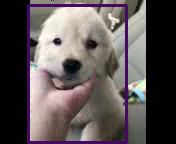

[[29, 0, 138, 146]] ['dog'] [0.8070608377456665]


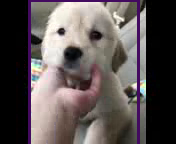

[[30, 2, 139, 142]] ['dog'] [0.6657895445823669]


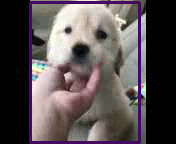

[[8, 13, 147, 132]] ['tv'] [0.8309022188186646]


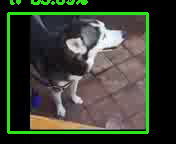

[[26, 17, 144, 126]] ['tv'] [0.7069202065467834]


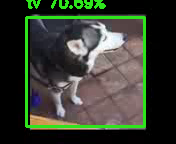

[[32, 18, 124, 119]] ['dog'] [0.5887011885643005]


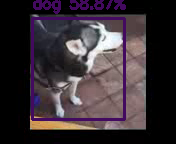

[[28, 16, 125, 122]] ['dog'] [0.4748503267765045]


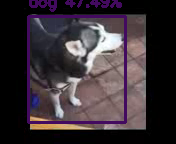

[[27, 17, 124, 122]] ['dog'] [0.4641583561897278]


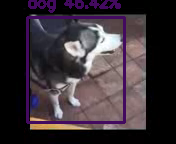

[[28, 13, 123, 117]] ['cat'] [0.40889957547187805]


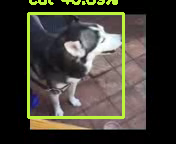

[[29, 13, 125, 117]] ['dog'] [0.7460039258003235]


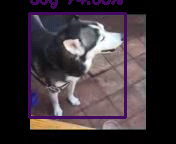

[[30, 17, 123, 122]] ['cat'] [0.5821124911308289]


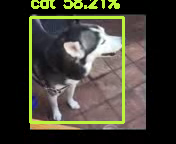

[[28, 15, 128, 128]] ['dog'] [0.8273457288742065]


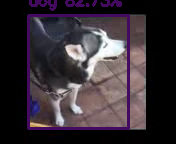

[[28, 14, 130, 128]] ['dog'] [0.8874240517616272]


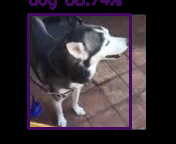

[[29, 14, 129, 129]] ['dog'] [0.9344679713249207]


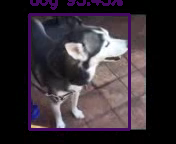

[[29, 17, 128, 129]] ['dog'] [0.8874045014381409]


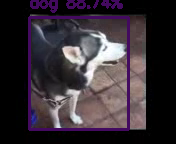

[[30, 17, 128, 130]] ['dog'] [0.74141526222229]


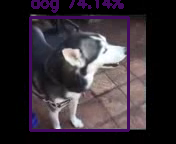

[[28, 17, 129, 131]] ['dog'] [0.9010981321334839]


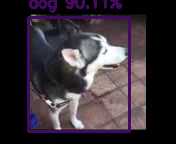

[[30, 17, 128, 131]] ['dog'] [0.8644554018974304]


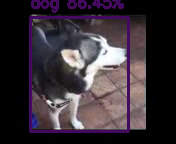

[[29, 14, 130, 131]] ['dog'] [0.8507309556007385]


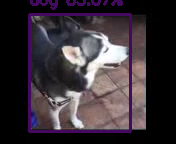

[[29, 17, 135, 129]] ['dog'] [0.9416797757148743]


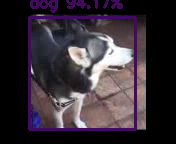

[[28, 17, 142, 128]] ['dog'] [0.910241961479187]


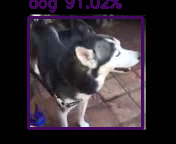

[[29, 16, 145, 130]] ['dog'] [0.827782928943634]


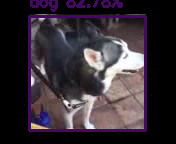

[] [] []


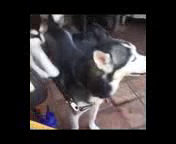

[[28, 12, 148, 134]] ['tv'] [0.8464230298995972]


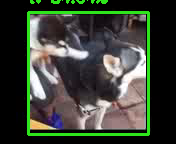

[[27, 11, 148, 134]] ['tv'] [0.8465225696563721]


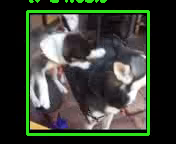

[[4, 4, 151, 141], [30, 45, 88, 126]] ['tv', 'person'] [0.8855270743370056, 0.2910732626914978]


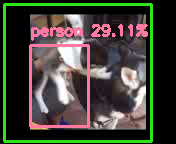

[[22, 7, 150, 138]] ['tv'] [0.8557856678962708]


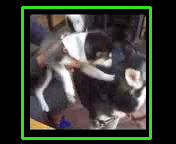

[[28, 12, 148, 134]] ['tv'] [0.9307911992073059]


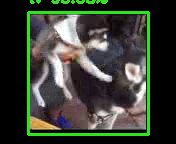

[[24, 11, 154, 134]] ['tv'] [0.8699234127998352]


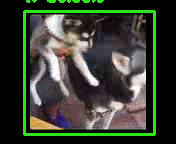

[[17, 12, 161, 134], [45, 15, 96, 107]] ['tv', 'person'] [0.9518038630485535, 0.2763309180736542]


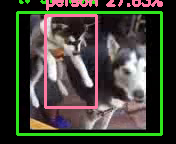

[[26, 10, 148, 135]] ['tv'] [0.8659709095954895]


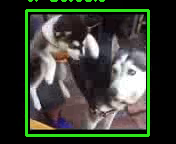

[[20, 11, 154, 134]] ['tv'] [0.8925900459289551]


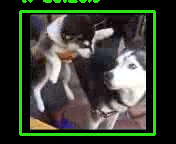

[[23, 10, 149, 134]] ['tv'] [0.7908096313476562]


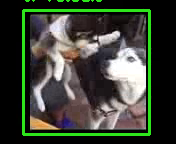

[[27, 11, 146, 134]] ['tv'] [0.9469785690307617]


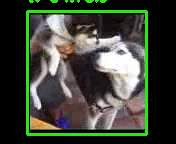

[[3, 8, 152, 138], [29, 23, 69, 118]] ['tv', 'person'] [0.6134505867958069, 0.36353108286857605]


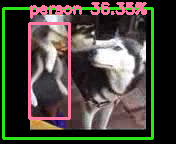

[[24, 7, 150, 134], [29, 21, 69, 123]] ['tv', 'person'] [0.8851829171180725, 0.33276957273483276]


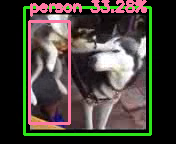

[[19, 11, 154, 132], [29, 38, 67, 126]] ['tv', 'person'] [0.8773848414421082, 0.43254154920578003]


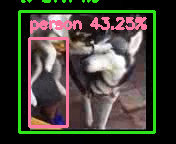

[[7, 11, 149, 130], [29, 20, 65, 126]] ['tv', 'person'] [0.7868494391441345, 0.41572055220603943]


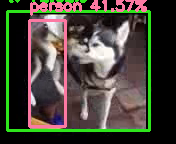

[[26, 12, 149, 131]] ['tv'] [0.7973387837409973]


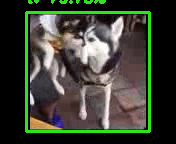

[[18, 12, 160, 127]] ['tv'] [0.8579402565956116]


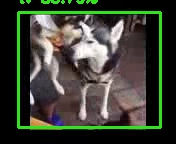

[[20, 10, 157, 131], [29, 16, 63, 123]] ['tv', 'cat'] [0.8799392580986023, 0.2867777645587921]


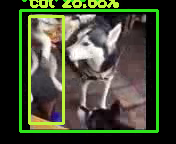

[[21, 10, 154, 131]] ['tv'] [0.8895952105522156]


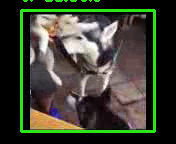

[[29, 11, 149, 131]] ['tv'] [0.9569140672683716]


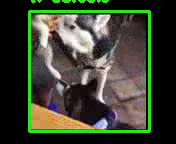

[[22, 9, 157, 134]] ['tv'] [0.9511091709136963]


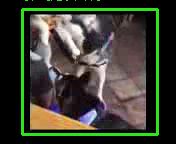

[[18, 9, 158, 136], [43, 14, 79, 61]] ['tv', 'person'] [0.933102011680603, 0.3252160847187042]


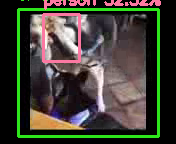

[[14, 10, 164, 134], [30, 16, 60, 81], [61, 16, 83, 59]] ['tv', 'person', 'person'] [0.7822200059890747, 0.4681292176246643, 0.28140196204185486]


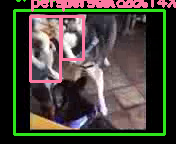

[[20, 10, 155, 136], [30, 18, 60, 78]] ['tv', 'person'] [0.9478727579116821, 0.28642335534095764]


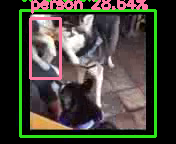

[[22, 10, 150, 133]] ['tv'] [0.8668680191040039]


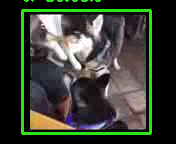

[[5, 9, 149, 135]] ['tv'] [0.9169679880142212]


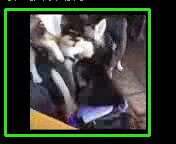

[[20, 4, 155, 141], [30, 17, 74, 125]] ['tv', 'person'] [0.7976788282394409, 0.3101865351200104]


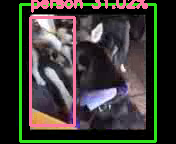

[[12, 3, 143, 142]] ['tv'] [0.9140795469284058]


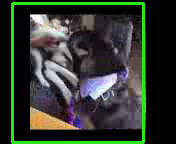

[[22, 10, 149, 138]] ['tv'] [0.7907566428184509]


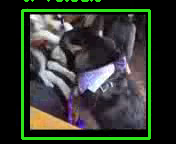

[[25, 10, 148, 135]] ['tv'] [0.9030448198318481]


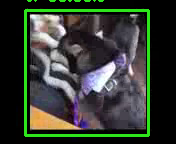

[[25, 6, 148, 136]] ['tv'] [0.5578762292861938]


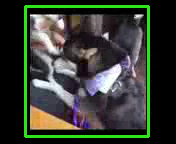

[] [] []


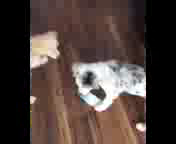

[] [] []


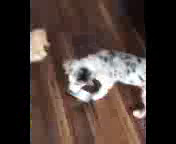

[[54, 40, 147, 144]] ['dog'] [0.3175109624862671]


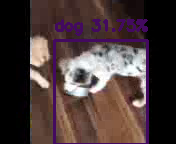

[[52, 36, 146, 143]] ['dog'] [0.43977469205856323]


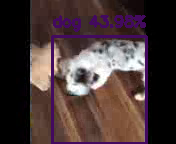

[[62, 30, 146, 95]] ['dog'] [0.26143476366996765]


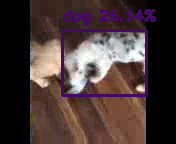

[[31, 23, 145, 140]] ['dog'] [0.32922375202178955]


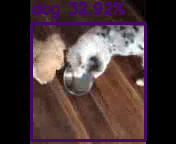

[[26, 5, 145, 142]] ['person'] [0.3032394051551819]


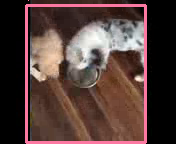

[[64, 12, 143, 86]] ['cat'] [0.4639616906642914]


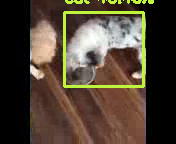

[[62, 11, 144, 85]] ['cat'] [0.5623504519462585]


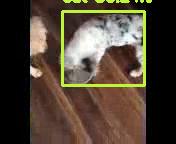

[[52, 11, 143, 85]] ['dog'] [0.5774182677268982]


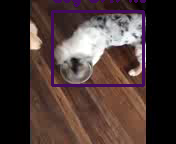

[[52, 11, 144, 84]] ['dog'] [0.41192111372947693]


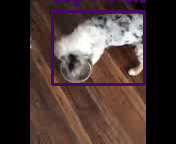

[] [] []


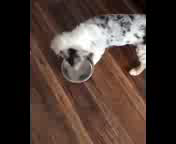

[[52, 12, 144, 83]] ['cat'] [0.3052530288696289]


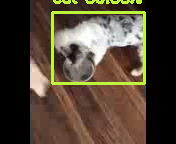

[[-1, 0, 31, 144]] ['tv'] [0.25297054648399353]


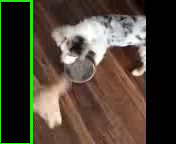

[] [] []


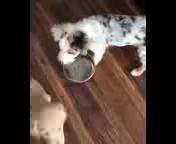

[] [] []


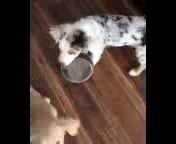

[[47, 14, 144, 81], [60, 52, 92, 83]] ['dog', 'bowl'] [0.4698198735713959, 0.27867382764816284]


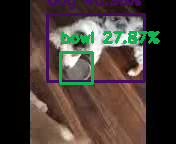

[[59, 52, 91, 83], [49, 14, 145, 79]] ['bowl', 'dog'] [0.8160942196846008, 0.4193296730518341]


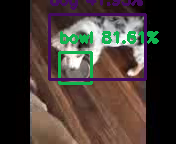

[[50, 12, 144, 81], [57, 54, 89, 83]] ['dog', 'bowl'] [0.4994204342365265, 0.3584268093109131]


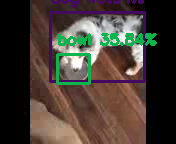

[[50, 11, 144, 82]] ['cat'] [0.4203142821788788]


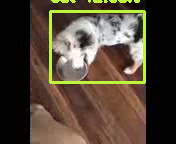

[[50, 11, 144, 82], [-1, 0, 33, 142]] ['dog', 'tv'] [0.4189769923686981, 0.35529521107673645]


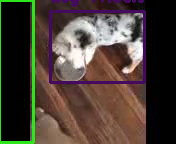

[[29, 8, 145, 140], [0, 0, 32, 142]] ['dog', 'tv'] [0.490670382976532, 0.26545193791389465]


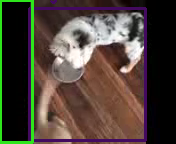

[[46, 7, 145, 74]] ['dog'] [0.5821062922477722]


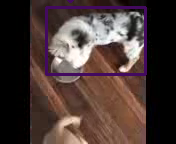

[[48, 8, 144, 87]] ['dog'] [0.3785073459148407]


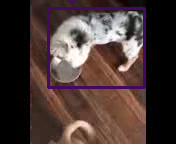

[[45, 7, 145, 90]] ['dog'] [0.38118812441825867]


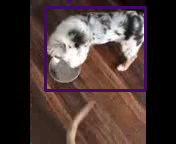

[[40, 8, 146, 83], [46, 57, 77, 81]] ['dog', 'frisbee'] [0.8631908297538757, 0.6127144694328308]


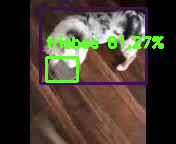

[[40, 8, 146, 84], [46, 55, 79, 83]] ['dog', 'frisbee'] [0.6957322359085083, 0.32124704122543335]


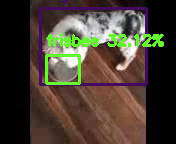

[[38, 5, 146, 78], [0, -1, 32, 143]] ['dog', 'tv'] [0.8425458669662476, 0.31441256403923035]


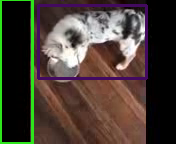

[[35, 2, 146, 79]] ['dog'] [0.6763476133346558]


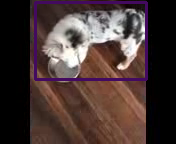

[[38, 7, 146, 84]] ['dog'] [0.6707973480224609]


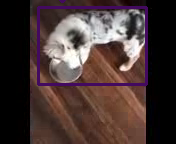

[[32, 0, 146, 79], [0, -1, 32, 143]] ['dog', 'tv'] [0.4580141603946686, 0.28035107254981995]


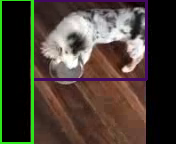

[[29, 3, 142, 140], [-1, -1, 33, 143]] ['dog', 'tv'] [0.4926239848136902, 0.3387860953807831]


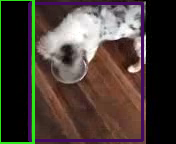

[[31, 1, 49, 52], [0, 0, 32, 141]] ['bottle', 'tv'] [0.6789969205856323, 0.3976935148239136]


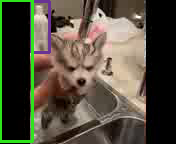

[[34, 2, 50, 48], [0, 0, 30, 142]] ['bottle', 'tv'] [0.9427531361579895, 0.5098654627799988]


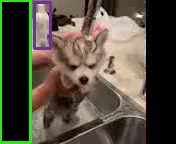

[[36, 2, 53, 47], [53, 9, 60, 31]] ['bottle', 'bottle'] [0.8930720090866089, 0.3948870599269867]


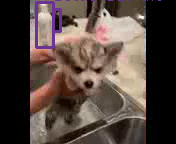

[[41, 8, 57, 47], [32, 42, 137, 144]] ['bottle', 'cat'] [0.9201162457466125, 0.2540130615234375]


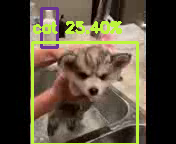

[[37, 2, 53, 46]] ['bottle'] [0.8059883713722229]


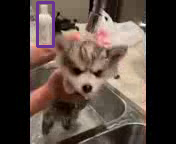

[[35, 1, 51, 39], [40, 81, 133, 143], [58, 122, 144, 143]] ['bottle', 'sink', 'sink'] [0.7464674115180969, 0.432750940322876, 0.2944859564304352]


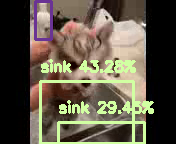

[[39, 0, 56, 33], [31, 1, 119, 122]] ['bottle', 'dog'] [0.7160011529922485, 0.526239812374115]


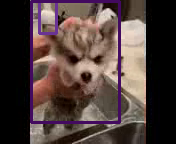

[[44, 0, 61, 33], [32, 26, 114, 137]] ['bottle', 'dog'] [0.7256945967674255, 0.4449172914028168]


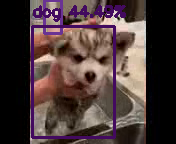

[[47, 2, 64, 55], [33, 28, 139, 137]] ['bottle', 'dog'] [0.6316704154014587, 0.38148850202560425]


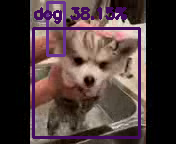

[] [] []


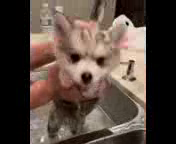

[[39, 2, 110, 140]] ['dog'] [0.7934561371803284]


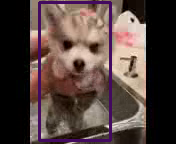

[[43, 37, 105, 128], [0, 0, 32, 141]] ['dog', 'tv'] [0.756446123123169, 0.3587571084499359]


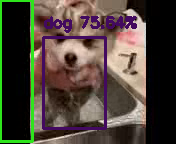

[[32, 1, 112, 124]] ['dog'] [0.6791946887969971]


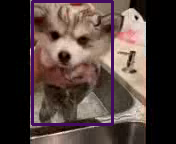

[[30, 10, 116, 127]] ['dog'] [0.45930808782577515]


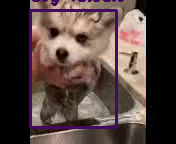

[[0, 0, 32, 142], [31, -1, 118, 123]] ['tv', 'dog'] [0.6712421774864197, 0.6265476942062378]


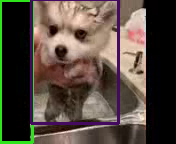

[[36, 0, 120, 125], [0, 0, 32, 141]] ['dog', 'tv'] [0.4677375853061676, 0.3256855309009552]


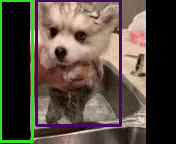

[[35, 1, 119, 132]] ['dog'] [0.5958369970321655]


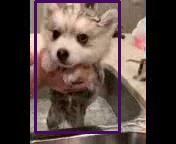

[[38, 4, 116, 133]] ['dog'] [0.7347860932350159]


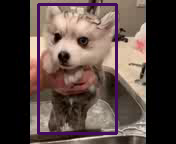

[[32, 5, 122, 135]] ['dog'] [0.8853567838668823]


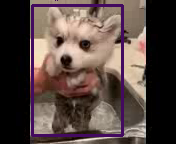

[[47, 3, 127, 138]] ['dog'] [0.7863345146179199]


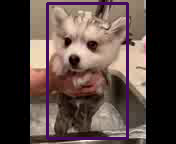

[[43, 1, 130, 138], [0, 0, 30, 143]] ['dog', 'tv'] [0.7767709493637085, 0.5973230600357056]


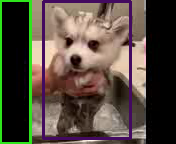

[[29, 7, 128, 135], [144, 2, 176, 139]] ['dog', 'tv'] [0.5644052028656006, 0.2524801194667816]


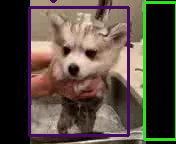

[[32, 7, 125, 136]] ['dog'] [0.5132232308387756]


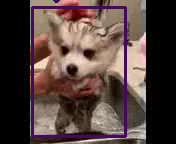

[[30, 9, 115, 137]] ['dog'] [0.3317006826400757]


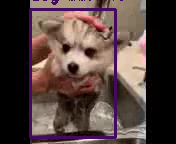

[[29, 12, 129, 133]] ['dog'] [0.6914752125740051]


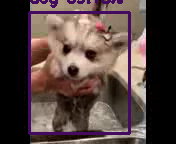

[[33, 7, 107, 135]] ['dog'] [0.6767408847808838]


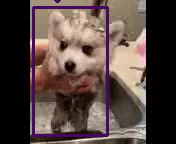

[[46, 83, 94, 132]] ['vase'] [0.5594385266304016]


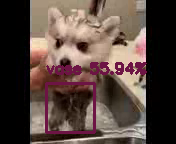

[[31, 3, 142, 133], [0, 0, 32, 142]] ['teddy bear', 'tv'] [0.6329675912857056, 0.3844073414802551]


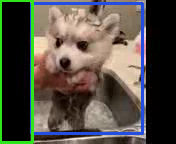

[[0, -1, 32, 143]] ['tv'] [0.49059805274009705]


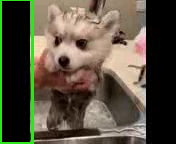

[[0, -1, 32, 143], [28, 2, 126, 135]] ['tv', 'dog'] [0.5154322385787964, 0.5007789134979248]


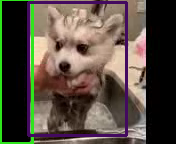

[[53, 15, 143, 142]] ['person'] [0.6553389430046082]


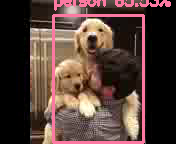

[] [] []


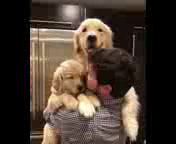

[[30, 59, 99, 142], [121, 82, 141, 143]] ['person', 'cat'] [0.370809406042099, 0.32362133264541626]


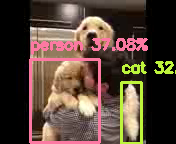

[[41, 60, 100, 143]] ['teddy bear'] [0.39660218358039856]


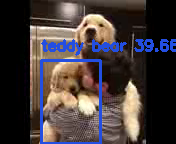

[[80, 40, 141, 143], [37, 54, 101, 142]] ['person', 'dog'] [0.4657565653324127, 0.28568950295448303]


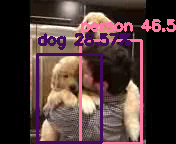

[[82, 40, 142, 144], [38, 52, 102, 143]] ['person', 'dog'] [0.5410813689231873, 0.40371474623680115]


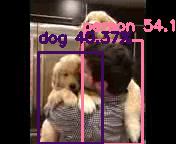

[[44, 52, 103, 112]] ['dog'] [0.5837445855140686]


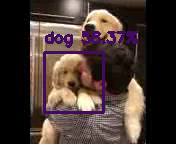

[[45, 52, 102, 111]] ['dog'] [0.5066845417022705]


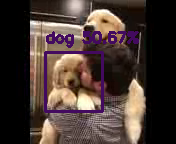

[[30, 51, 98, 142]] ['dog'] [0.3595292270183563]


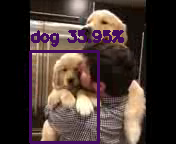

[[43, 49, 98, 145]] ['teddy bear'] [0.4077138900756836]


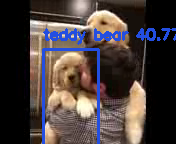

[[40, 50, 99, 143]] ['teddy bear'] [0.5726045370101929]


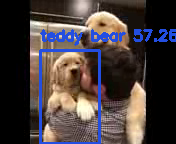

[[43, 50, 100, 143], [75, 10, 128, 51]] ['dog', 'dog'] [0.6496272087097168, 0.2939845621585846]


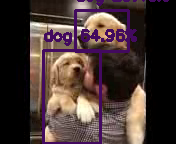

[[73, 10, 136, 138]] ['dog'] [0.39998918771743774]


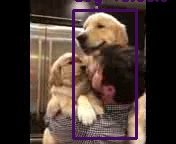

[[42, 52, 99, 141], [73, 11, 128, 106]] ['teddy bear', 'dog'] [0.5241764783859253, 0.2652894854545593]


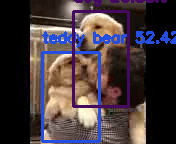

[[38, 53, 106, 141], [74, 11, 146, 140]] ['dog', 'dog'] [0.8364855647087097, 0.7680642604827881]


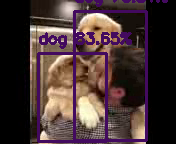

[[38, 53, 108, 139], [75, 11, 145, 138]] ['dog', 'dog'] [0.9017234444618225, 0.46008121967315674]


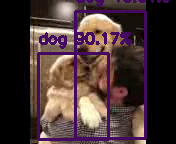

[[38, 53, 110, 142], [77, 13, 145, 136]] ['dog', 'dog'] [0.8614829182624817, 0.49800682067871094]


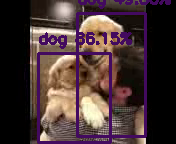

[[37, 54, 113, 140], [75, 16, 132, 134]] ['dog', 'dog'] [0.86836838722229, 0.3019569218158722]


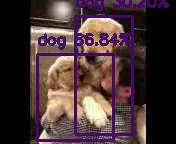

[[37, 53, 113, 140], [73, 13, 128, 107]] ['dog', 'dog'] [0.9244673848152161, 0.29138872027397156]


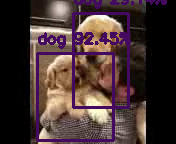

[[34, 51, 111, 143], [73, 12, 135, 138]] ['dog', 'dog'] [0.8865580558776855, 0.26788076758384705]


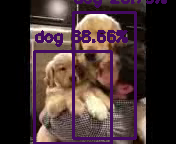

[[33, 50, 111, 141], [70, 10, 128, 108]] ['dog', 'dog'] [0.7238331437110901, 0.25428104400634766]


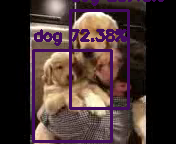

[[30, 49, 109, 140]] ['dog'] [0.617650032043457]


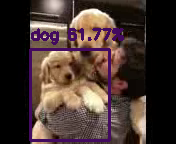

[[31, 47, 107, 140]] ['dog'] [0.8506737947463989]


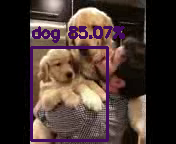

[[28, 48, 103, 142], [29, 0, 70, 20]] ['dog', 'tv'] [0.5536260604858398, 0.47830840945243835]


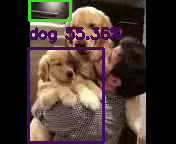

[[62, 7, 121, 95], [30, 0, 70, 20], [30, 46, 101, 117]] ['dog', 'tv', 'dog'] [0.42970484495162964, 0.42417579889297485, 0.3882840871810913]


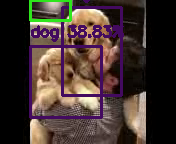

[[28, 47, 116, 143], [30, 0, 72, 20], [62, 5, 118, 94]] ['dog', 'tv', 'dog'] [0.43612560629844666, 0.35397568345069885, 0.2635636627674103]


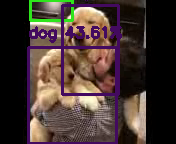

[[63, 6, 116, 108], [28, 48, 83, 141]] ['dog', 'dog'] [0.8770513534545898, 0.40318480134010315]


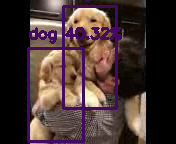

[[65, 5, 119, 108], [29, 47, 110, 142]] ['dog', 'dog'] [0.6404210925102234, 0.5586952567100525]


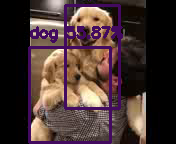

[[55, 5, 122, 109]] ['dog'] [0.40633025765419006]


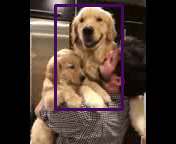

[[66, 6, 118, 108]] ['dog'] [0.5352561473846436]


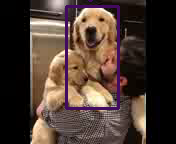

[[29, 49, 115, 143], [73, 7, 121, 109]] ['dog', 'dog'] [0.6630228757858276, 0.43862536549568176]


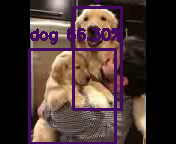

[[73, 6, 120, 108], [28, 47, 119, 143]] ['dog', 'dog'] [0.3450538218021393, 0.2684689462184906]


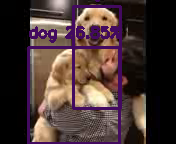

[[30, 6, 124, 137]] ['dog'] [0.54349285364151]


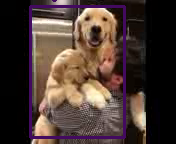

[[34, 48, 108, 140], [62, 3, 116, 98]] ['teddy bear', 'dog'] [0.4899328947067261, 0.2909530997276306]


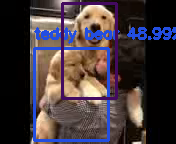

[[75, 3, 116, 96]] ['dog'] [0.489747554063797]


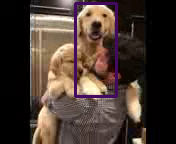

[] [] []


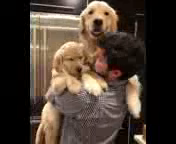

[[79, 0, 121, 78], [49, 39, 105, 109]] ['teddy bear', 'teddy bear'] [0.33866047859191895, 0.3205767869949341]


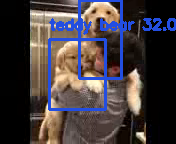

[[44, 39, 105, 140]] ['teddy bear'] [0.3114968538284302]


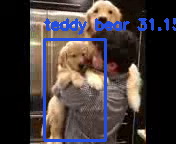

[[59, -1, 139, 145]] ['person'] [0.41730377078056335]


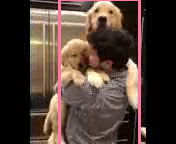

[[69, -2, 135, 148], [45, 38, 101, 141]] ['teddy bear', 'teddy bear'] [0.2636299133300781, 0.25582969188690186]


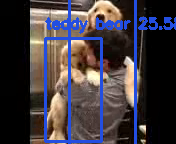

[[62, 28, 136, 144]] ['person'] [0.6803542971611023]


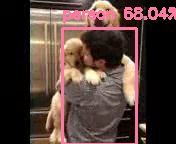

[[64, 28, 136, 143]] ['person'] [0.7902455925941467]


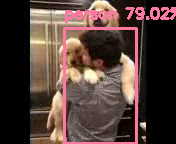

[[62, 27, 136, 143]] ['person'] [0.8410918116569519]


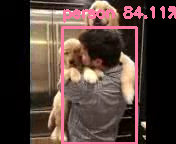

[[60, 25, 137, 142]] ['person'] [0.8055267333984375]


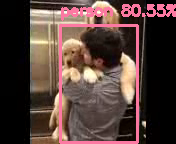

[[57, 27, 138, 143]] ['person'] [0.8384291529655457]


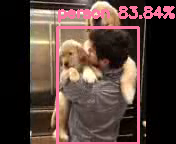

[[54, 21, 141, 143]] ['person'] [0.7468554377555847]


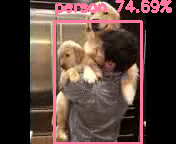

[[53, 4, 144, 141]] ['person'] [0.820477306842804]


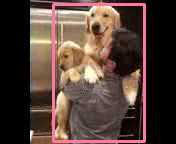

[[57, 2, 138, 143]] ['person'] [0.5514001250267029]


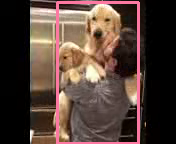

[[56, 4, 141, 141]] ['person'] [0.8275617957115173]


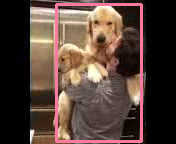

[[56, 3, 143, 145]] ['person'] [0.8280253410339355]


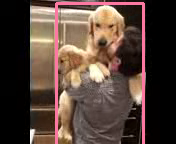

[[55, 0, 141, 146]] ['person'] [0.915157675743103]


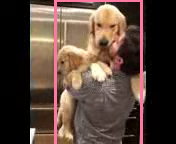

[[55, 0, 140, 146], [61, 40, 111, 100]] ['person', 'teddy bear'] [0.9473012685775757, 0.2579357624053955]


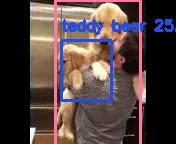

[[57, 0, 142, 144]] ['person'] [0.9147701859474182]


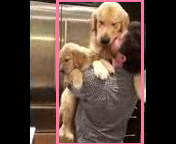

[[64, -2, 140, 146], [52, 40, 92, 141]] ['person', 'dog'] [0.733456552028656, 0.28364166617393494]


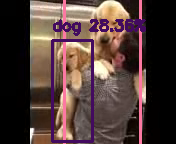

[[50, 36, 92, 141], [60, -1, 144, 143]] ['dog', 'person'] [0.49706223607063293, 0.37921223044395447]


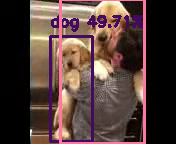

[[62, -1, 143, 143], [49, 36, 92, 138]] ['person', 'dog'] [0.4299769997596741, 0.2687699496746063]


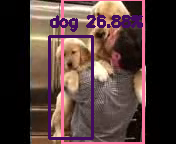

[[54, 0, 146, 141]] ['dog'] [0.5291853547096252]


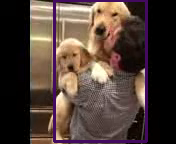

[[55, -1, 145, 143]] ['dog'] [0.6333169937133789]


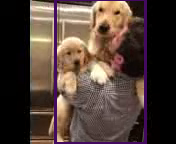

[[25, 8, 149, 136]] ['tv'] [0.9605373740196228]


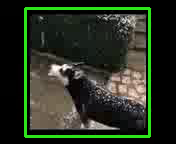

[[18, 5, 158, 139]] ['tv'] [0.9725446701049805]


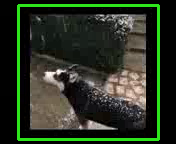

[[6, 4, 147, 141]] ['tv'] [0.8735077977180481]


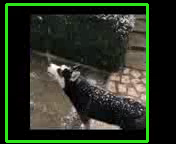

[[20, 7, 153, 137]] ['tv'] [0.9001919627189636]


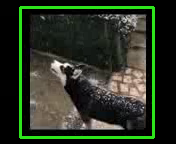

[[24, 8, 152, 136]] ['tv'] [0.9669750928878784]


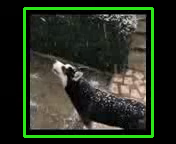

[[21, 7, 151, 137]] ['tv'] [0.9321593642234802]


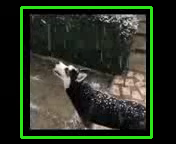

[[20, 5, 158, 139]] ['tv'] [0.9565743803977966]


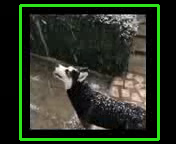

[[23, 6, 155, 139]] ['tv'] [0.9623367786407471]


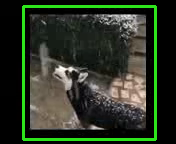

[[21, 10, 157, 135]] ['tv'] [0.9569362998008728]


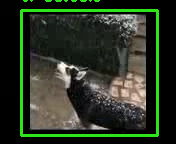

[[21, 7, 152, 136]] ['tv'] [0.9157678484916687]


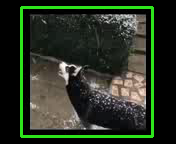

[[21, 9, 155, 134]] ['tv'] [0.9564768671989441]


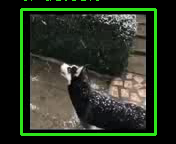

[[18, 9, 155, 132]] ['tv'] [0.9715266823768616]


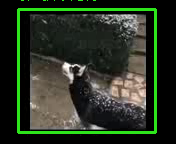

[[19, 10, 159, 132]] ['tv'] [0.9748991131782532]


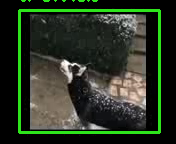

KeyboardInterrupt: ignored

In [ ]:
# loop through frames
while video.isOpened():

    # read frame from webcam 
    status, frame = video.read()

    if not status:
        break

    # apply object detection
    bbox, label, conf = cv.detect_common_objects(frame, confidence=0.25, model='yolov3-tiny')

    print(bbox, label, conf)

    # draw bounding box over detected objects
    out = draw_bbox(frame, bbox, label, conf, write_conf=True)

    # display output
    cv2_imshow(out)


## Object Detection from Images and Counting Objects 

In [ ]:
import cv2
import matplotlib.pyplot as plt
import cvlib
from cvlib.object_detection import draw_bbox
from google.colab.patches import cv2_imshow

def image_Object_Detection(image_file):
	# reading the image
    img = cv2.imread(image_file)
    # detect common objects
    bbox, label, conf = cvlib.detect_common_objects(img)
    # draw bbox around the objects
    output_image = draw_bbox(img, bbox, label, conf)
    # show and plot the image
    #plt.imshow(output_image)
    #plt.show()
    cv2_imshow(output_image)
	
	# print the number of different labels found in the images
    for item in set(label):
        print(f'Number of {item} in the image is {str(label.count(item))}')


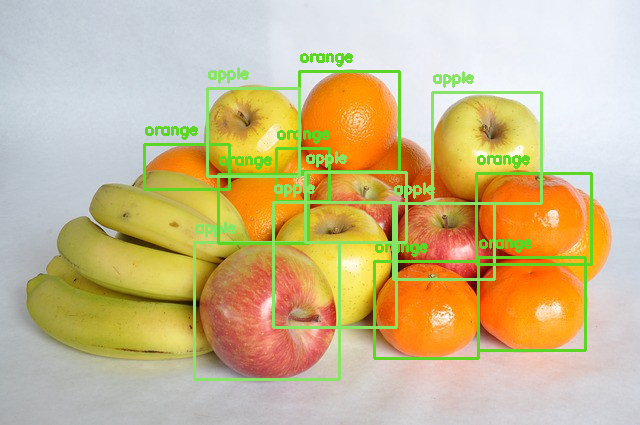

Number of apple in the image is 6
Number of orange in the image is 7


In [ ]:
image = "/content/1*4QW4-Yz6izpbyCiZv6bSPA.jpeg"
image_Object_Detection(image)

In [ ]:
!wget https://predictivehacks.com/wp-content/uploads/2019/10/cycling001-1024x683.jpg

--2022-10-09 12:04:09--  https://predictivehacks.com/wp-content/uploads/2019/10/cycling001-1024x683.jpg
Resolving predictivehacks.com (predictivehacks.com)... 172.67.177.213, 104.21.91.187, 2606:4700:3034::6815:5bbb, ...
Connecting to predictivehacks.com (predictivehacks.com)|172.67.177.213|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 149182 (146K) [image/jpeg]
Saving to: ‘cycling001-1024x683.jpg’

cycling001-1024x683 100%[===================>] 145.69K  --.-KB/s    in 0.05s   

2022-10-09 12:04:09 (2.71 MB/s) - ‘cycling001-1024x683.jpg’ saved [149182/149182]



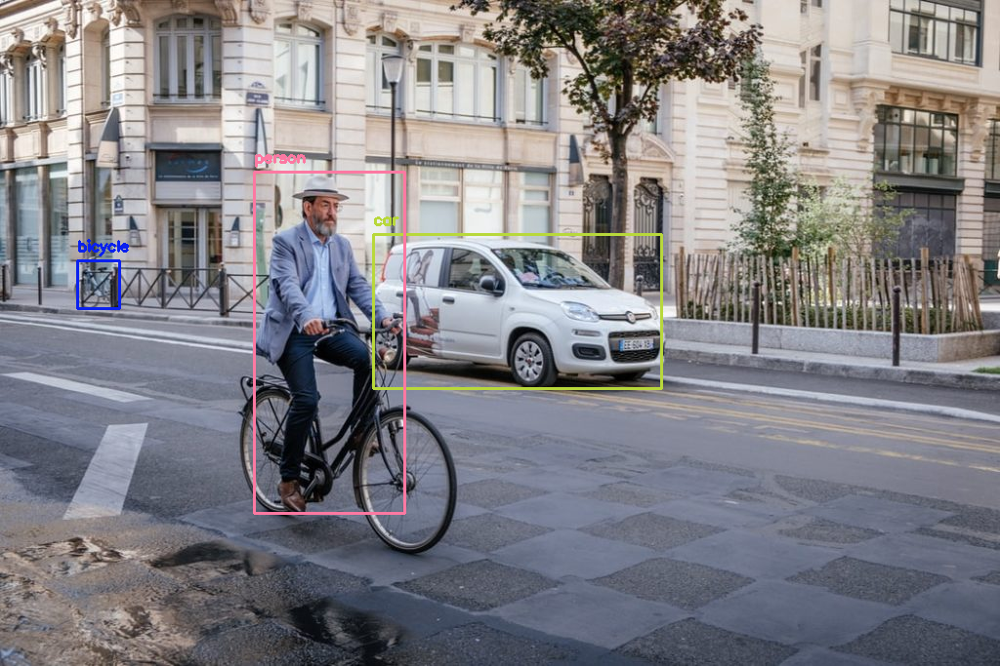

Number of person in the image is 1
Number of bicycle in the image is 1
Number of car in the image is 1


In [ ]:
image = "/content/cycling001-1024x683.jpg"
image_Object_Detection(image)